In [5]:
# uncomment to install the necessary libraries in Colab
!pip install diffusers


[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: pip install --upgrade pip


In [2]:
!pip install accelerate




[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: pip install --upgrade pip


In [6]:
!pip install datasets


[notice] A new release of pip is available: 25.0.1 -> 25.1
[notice] To update, run: pip install --upgrade pip


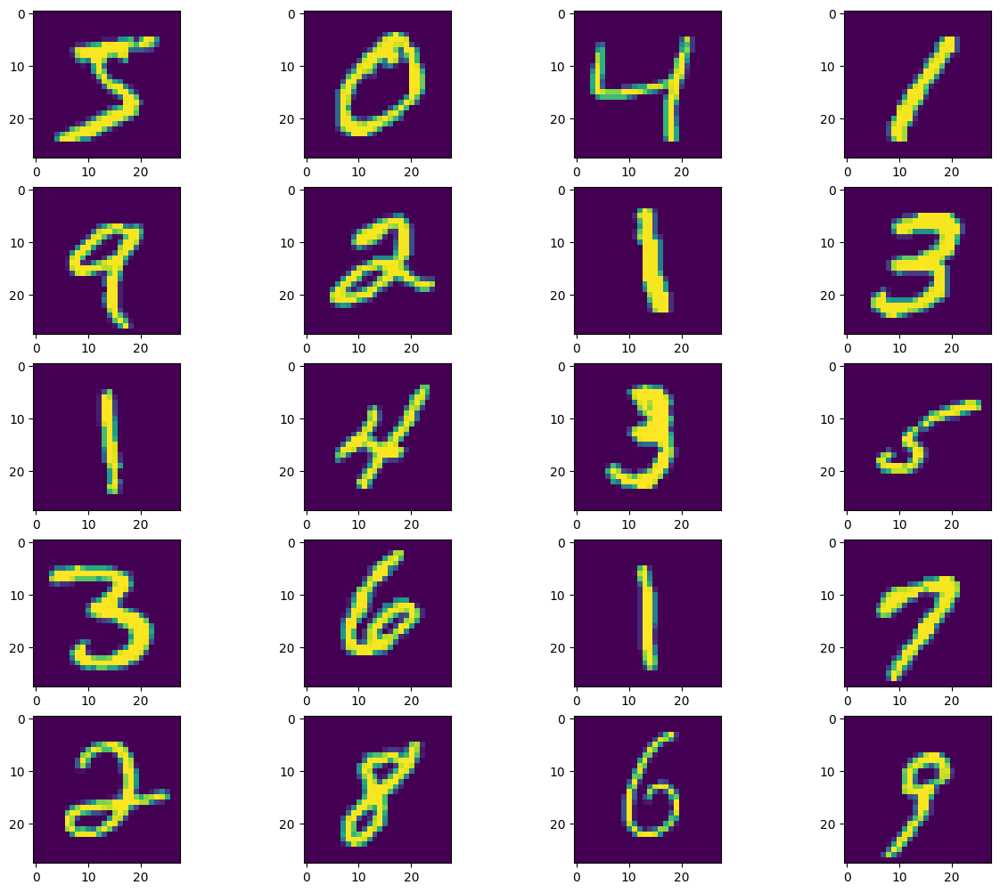

In [7]:
import torch
import torchvision
import matplotlib.pyplot as plt
def show_images(dataset, num_samples=20, cols =4):
  """ plots"""
  plt.figure(figsize=(15,15))
  for i, img in enumerate(dataset):
    if i == num_samples:
      break
    plt.subplot(int(num_samples/cols) +1, cols, i+1)

    plt.imshow(img[0])

data = torchvision.datasets.MNIST(root='.', download=True)
show_images(data)

In [25]:
from dataclasses import dataclass

@dataclass
class TrainingConfig:
    image_size = 32  # the generated image resolution
    train_batch_size = 64
    eval_batch_size = 16  # how many images to sample during evaluation
    num_epochs = 5
    gradient_accumulation_steps = 1
    learning_rate = 1e-4
    lr_warmup_steps = 500
    save_image_epochs = 10
    save_model_epochs = 30
    mixed_precision = "fp16"  # `no` for float32, `fp16` for automatic mixed precision
    output_dir = "MNIST"  # the model name locally and on the HF Hub

    push_to_hub = False  # whether to upload the saved model to the HF Hub
    hub_model_id = "<your-username>/<my-awesome-model>"  # the name of the repository to create on the HF Hub
    hub_private_repo = False
    overwrite_output_dir = True  # overwrite the old model when re-running the notebook
    seed = 0


config = TrainingConfig()

In [9]:
#transfert the torchvision mnist dataset to hugging face dataset
from datasets import Dataset ,Features ,Image


data = torchvision.datasets.MNIST(root='.', download=True)

print(data.data.shape)
datasetdict = {"images":data.data}


features = Features({"image": Image()})
dataset = Dataset.from_dict({"image": data.data}, features=features)
dataset = dataset.with_format("torch")



torch.Size([60000, 28, 28])


In [10]:
from torchvision import transforms

preprocess = transforms.Compose(
    [   transforms.Resize((config.image_size, config.image_size)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),
    ]
)

In [11]:
def transform(examples):
    print(examples["image"])
    images = [preprocess(image) for image in examples["image"]]
    return {"images": images}


dataset.set_transform(transform)

In [12]:
import torch

train_dataloader = torch.utils.data.DataLoader(dataset, batch_size=config.train_batch_size, shuffle=True)

In [13]:
from diffusers import UNet2DModel

model = UNet2DModel(
    sample_size=config.image_size,  # the target image resolution
    in_channels=1,  # the number of input channels, 3 for RGB images
    out_channels=1,  # the number of output channels
    layers_per_block=2,  # how many ResNet layers to use per UNet block
    block_out_channels=(128,128,256,512),  # the number of output channels for each UNet block
    down_block_types=(
        "DownBlock2D",
        "DownBlock2D",
        "AttnDownBlock2D",
        "DownBlock2D",
    ),
    up_block_types=(
        "UpBlock2D",
        "AttnUpBlock2D",
        "UpBlock2D",
        "UpBlock2D",
    ),
)


In [14]:
sample_image = dataset[0]["images"].unsqueeze(0)
print("Input shape:", sample_image.shape)

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3B05A4C70>]
Input shape: torch.Size([1, 1, 32, 32])


In [15]:
print("Output shape:", model(sample_image, timestep=0).sample.shape)

Output shape: torch.Size([1, 1, 32, 32])


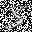

In [16]:
import torch
from PIL import Image
from diffusers import DDPMScheduler
import numpy as np


noise_scheduler = DDPMScheduler(num_train_timesteps=1000)
noise = torch.randn(sample_image.shape)
timesteps = torch.LongTensor([50])
noisy_image = noise_scheduler.add_noise(sample_image, noise, timesteps)



Image.fromarray(((noisy_image.permute(0, 2, 3, 1) + 1.0) * 127.5).numpy().astype(np.uint8)[0].squeeze(-1) ,mode="L")


In [17]:
import torch.nn.functional as F

noise_pred = model(noisy_image, timesteps).sample
loss = F.mse_loss(noise_pred, noise)

In [18]:
from diffusers.optimization import get_cosine_schedule_with_warmup

optimizer = torch.optim.AdamW(model.parameters(), lr=config.learning_rate)
lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=config.lr_warmup_steps,
    num_training_steps=(len(train_dataloader) * config.num_epochs),
)

In [19]:
from diffusers import DDPMPipeline
from diffusers.utils import make_image_grid
import os

def evaluate(config, epoch, pipeline):
    # Sample some images from random noise (this is the backward diffusion process).
    # The default pipeline output type is `List[PIL.Image]`
    images = pipeline(
        batch_size=config.eval_batch_size,
        generator=torch.manual_seed(config.seed),
    ).images

    # Make a grid out of the images
    image_grid = make_image_grid(images, rows=4, cols=4)

    #SHOW IMAGE
    plt.figure(figsize=(10,10))
    plt.imshow(image_grid)
    plt.show()

    # Save the images
    test_dir = os.path.join(config.output_dir, "samples")
    os.makedirs(test_dir, exist_ok=True)
    image_grid.save(f"{test_dir}/{epoch:04d}.png")

In [26]:
from accelerate import Accelerator
from huggingface_hub import create_repo, upload_folder
from tqdm.auto import tqdm
from pathlib import Path
import os

def train_loop(config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler):
    # Initialize accelerator and tensorboard logging
    accelerator = Accelerator(
        mixed_precision=config.mixed_precision,
        gradient_accumulation_steps=config.gradient_accumulation_steps,
        log_with="tensorboard",
        project_dir=os.path.join(config.output_dir, "logs"),
    )
    if accelerator.is_main_process:
        if config.output_dir is not None:
            os.makedirs(config.output_dir, exist_ok=True)
        if config.push_to_hub:
            repo_id = create_repo(
                repo_id=config.hub_model_id or Path(config.output_dir).name, exist_ok=True
            ).repo_id
        accelerator.init_trackers("train_example")

    # Prepare everything
    # There is no specific order to remember, you just need to unpack the
    # objects in the same order you gave them to the prepare method.
    model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
        model, optimizer, train_dataloader, lr_scheduler
    )

    global_step = 0

    # Now you train the model
    for epoch in range(config.num_epochs):
        progress_bar = tqdm(total=len(train_dataloader), disable=not accelerator.is_local_main_process)
        progress_bar.set_description(f"Epoch {epoch}")

        for step, batch in enumerate(train_dataloader):
            clean_images = batch["images"]
            # Sample noise to add to the images
            noise = torch.randn(clean_images.shape, device=clean_images.device)
            bs = clean_images.shape[0]

            # Sample a random timestep for each image
            timesteps = torch.randint(
                0, noise_scheduler.config.num_train_timesteps, (bs,), device=clean_images.device,
                dtype=torch.int64
            )

            # Add noise to the clean images according to the noise magnitude at each timestep
            # (this is the forward diffusion process)
            noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)

            with accelerator.accumulate(model):
                # Predict the noise residual
                noise_pred = model(noisy_images, timesteps, return_dict=False)[0]
                loss = F.mse_loss(noise_pred, noise)
                accelerator.backward(loss)

                accelerator.clip_grad_norm_(model.parameters(), 1.0)
                optimizer.step()
                lr_scheduler.step()
                optimizer.zero_grad()

            progress_bar.update(1)
            logs = {"loss": loss.detach().item(), "lr": lr_scheduler.get_last_lr()[0], "step": global_step}
            progress_bar.set_postfix(**logs)
            accelerator.log(logs, step=global_step)
            global_step += 1

        # After each epoch you optionally sample some demo images with evaluate() and save the model
        if accelerator.is_main_process:
            pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)

            if (epoch + 1) % config.save_image_epochs == 0 or epoch == config.num_epochs - 1:
                evaluate(config, epoch, pipeline)

            if (epoch + 1) % config.save_model_epochs == 0 or epoch == config.num_epochs - 1:
                if config.push_to_hub:
                    upload_folder(
                        repo_id=repo_id,
                        folder_path=config.output_dir,
                        commit_message=f"Epoch {epoch}",
                        ignore_patterns=["step_*", "epoch_*"],
                    )
                else:
                    pipeline.save_pretrained(config.output_dir)

Launching training on one GPU.


  0%|          | 0/938 [00:00<?, ?it/s]

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F82710>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83CD0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83A00>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83970>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83940>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F839D0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83AC0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83AF0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83A60>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83B80>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83BE0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83C40>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE394F83EE0>

  0%|          | 0/938 [00:00<?, ?it/s]

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EE230>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EEA10>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EC340>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EF190>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EEAA0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EDF90>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EEFE0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958ECAF0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EEE30>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EDB40>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EC1F0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958EE2F0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958ED450>

  0%|          | 0/938 [00:00<?, ?it/s]

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F3130>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F03A0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F37C0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F2110>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F00A0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F2830>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F38B0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F3D60>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F1960>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F3F10>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F1D80>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F1AE0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F1120>

  0%|          | 0/938 [00:00<?, ?it/s]

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F1D50>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958F31C0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958E8400>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395845450>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958446A0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395845CF0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844F70>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844430>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844BB0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958442E0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844A00>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395845390>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844A90>

  0%|          | 0/938 [00:00<?, ?it/s]

[<PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844BB0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958445B0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958446A0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844EE0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958454B0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395845CF0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844070>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844FD0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395844A00>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE395845750>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958466E0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958453C0>, <PIL.PngImagePlugin.PngImageFile image mode=L size=28x28 at 0x7EE3958462C0>

  0%|          | 0/1000 [00:00<?, ?it/s]

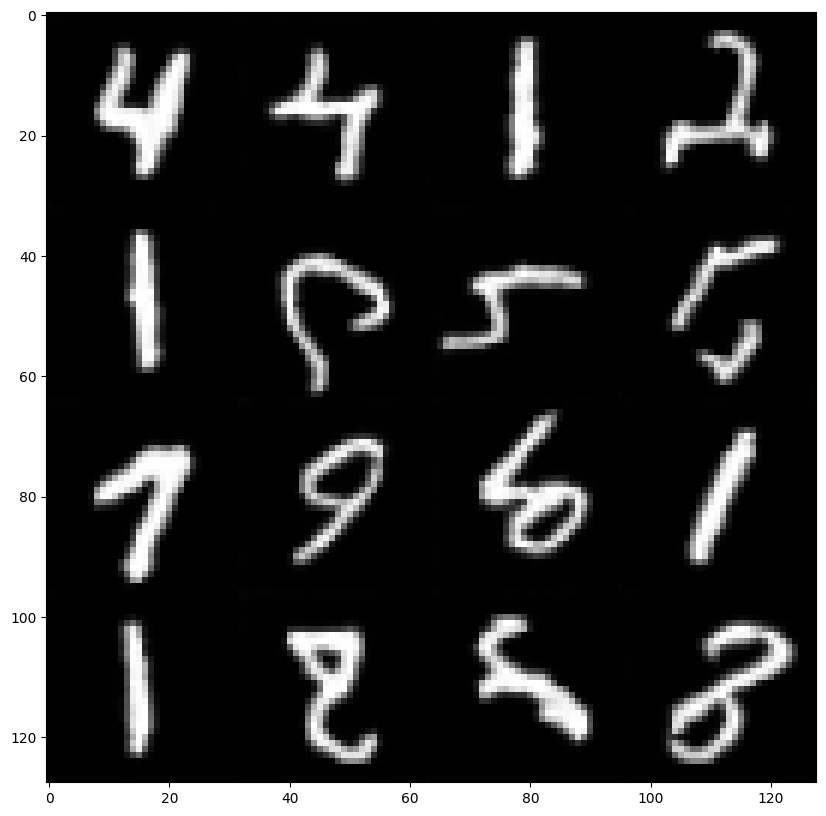

In [27]:
from accelerate import notebook_launcher

args = (config, model, noise_scheduler, optimizer, train_dataloader, lr_scheduler)

notebook_launcher(train_loop, args, num_processes=1)

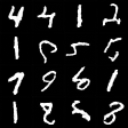

In [28]:
import glob

sample_images = sorted(glob.glob(f"{config.output_dir}/samples/*.png"))
sample_images
Image.open(sample_images[-1])

In [29]:
import os
import torch
from diffusers import DDPMPipeline

def save_trained_model(model, noise_scheduler, save_directory):
    """
    Saves the trained model and scheduler as a DDPMPipeline.
    
    Args:
        model: The trained UNet model.
        noise_scheduler: The noise scheduler used during training.
        save_directory: Path to directory where the model will be saved.
    """
    os.makedirs(save_directory, exist_ok=True)

    # Create a pipeline combining model and scheduler
    pipeline = DDPMPipeline(
        unet=model,
        scheduler=noise_scheduler,
    )

    # Save the full pipeline
    pipeline.save_pretrained(save_directory)
    print(f"Model saved successfully to: {save_directory}")

# --- Example usage after training ---

# Assuming you have `model` and `noise_scheduler` after training


In [30]:
save_trained_model(
    model=model, 
    noise_scheduler=noise_scheduler, 
    save_directory="./path/to/save/your_model"
)


Model saved successfully to: ./path/to/save/your_model


In [35]:
import torch
from diffusers import DDPMPipeline
from PIL import Image
import os
from tqdm.auto import tqdm

def load_and_generate(
    model_directory,
    output_directory,
    num_images=16,
    batch_size=4,
    device="cuda" if torch.cuda.is_available() else "cpu",
):
    """
    Load a saved DDPMPipeline model and generate images.
    
    Args:
        model_directory: Path to the saved model directory.
        output_directory: Where to save the generated images.
        num_images: How many images to generate.
        batch_size: Number of images to generate at once.
        device: "cuda" or "cpu".
    """
    print("huh")
    # Load the trained diffusion pipeline
    pipeline = DDPMPipeline.from_pretrained(model_directory)
    pipeline = pipeline.to(device)
    pipeline.set_progress_bar_config(disable=False)

    os.makedirs(output_directory, exist_ok=True)

    print(f"Loaded model from {model_directory}")
    print(f"Generating {num_images} images...")

    generated = []
    num_batches = (num_images + batch_size - 1) // batch_size  # Ceiling division

    for _ in tqdm(range(num_batches)):
        with torch.no_grad():
            batch = pipeline(batch_size=batch_size).images
            generated.extend(batch)

    # Save images
    for idx, image in enumerate(generated[:num_images]):  # in case we generate more
        image_path = os.path.join(output_directory, f"generated_{idx:04d}.png")
        image.save(image_path)

    print(f"Saved {min(num_images, len(generated))} images to {output_directory}")

# --- Example usage ---


In [36]:
load_and_generate(
    model_directory="./path/to/your/trained_model",  # <<< put your trained model path here
    output_directory="./generated_samples",
    num_images=20,
    batch_size=64,
)


huh


ValueError: The provided pretrained_model_name_or_path "./path/to/your/trained_model" is neither a valid local path nor a valid repo id. Please check the parameter.